In [67]:
import xarray as xr
import geopandas as gpd
import pandas as pd
import numpy as np
import shapely.geometry
import shapely
from shapely import wkt
import rasterio
from rasterio import features
import rioxarray
from rasterio.features import shapes
from rasterio.enums import MergeAlg
from rasterio.plot import show
from numpy import int16
from shapely.geometry import shape
import matplotlib.pyplot as plt
from pathlib import Path
import shapely.plotting
from shapely.geometry import Polygon

import shapely.wkt
import shapely.geometry

len wind =  8381
len Solar =  40946


<Axes: >

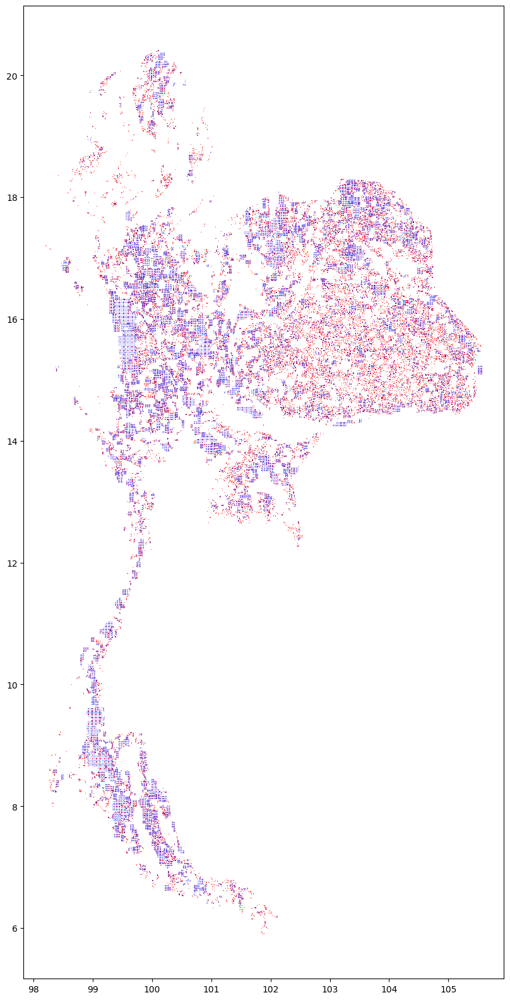

In [68]:
df_final_SI_Wind = pd.read_csv('Output_SolarWind\\df_final_SI_Wind.csv')
df_final_SI_Solar = pd.read_csv('Output_SolarWind\\df_final_SI_Solar.csv')
df_final_SI_Wind['geometry'] = df_final_SI_Wind['geometry'].apply(wkt.loads)
df_final_SI_Solar['geometry'] = df_final_SI_Solar['geometry'].apply(wkt.loads)
gdp_final_SI_Wind = gpd.GeoDataFrame(df_final_SI_Wind, crs='epsg:4326')
gdp_final_SI_Solar = gpd.GeoDataFrame(df_final_SI_Solar, crs='epsg:4326')

gdp_final_SI_Wind = gdp_final_SI_Wind.drop(columns=['raster_val','center'])
gdp_final_SI_Solar = gdp_final_SI_Solar.drop(columns=['raster_val','center'])

print("len wind = ",len(gdp_final_SI_Wind))
print("len Solar = ",len(gdp_final_SI_Solar))

fig, ax = plt.subplots(figsize=(20,20))
gdp_final_SI_Solar.geometry.plot(ax = ax, color='red',alpha = 0.8,zorder = 0)
gdp_final_SI_Wind.geometry.plot(ax = ax, color='blue',alpha = 0.4,zorder = 1)

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


<Axes: >

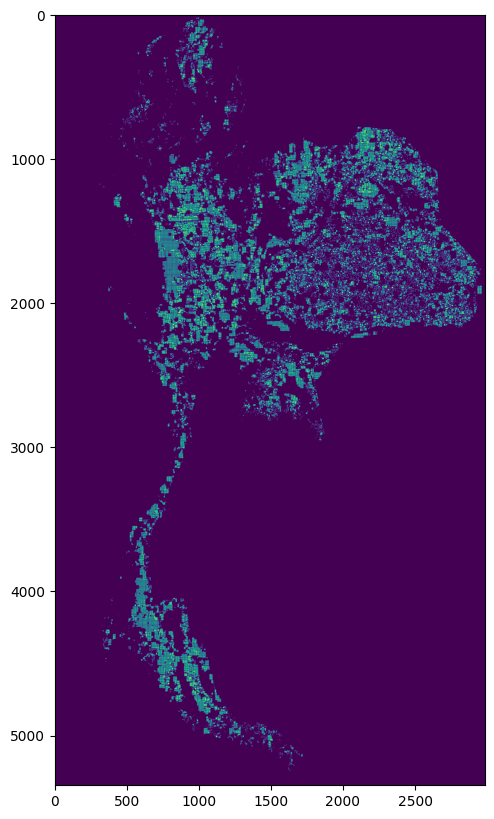

In [69]:
xr_rasterized_wind = rasterio.open('Output_SolarWind\\xr_AVA_Wind.nc')
geom = [shapes for shapes in gdp_final_SI_Wind.geometry]

rasterized_wind = features.rasterize(geom,
                                out_shape = xr_rasterized_wind.shape,
                                fill = 0,
                                out = None,
                                transform = xr_rasterized_wind.transform,
                                all_touched = True,
                                default_value = 1,
                                dtype = None)

xr_rasterized_solar = rasterio.open('Output_SolarWind\\xr_AVA_solar.nc')
geom = [shapes for shapes in gdp_final_SI_Solar.geometry]

rasterized_solar = features.rasterize(geom,
                                out_shape = xr_rasterized_solar.shape,
                                fill = 0,
                                out = None,
                                transform = xr_rasterized_solar.transform,
                                all_touched = True,
                                default_value = 1,
                                dtype = None)


rasterized = rasterized_wind+rasterized_solar
print(rasterized)
# Plot raster
fig, ax = plt.subplots(1, figsize = (10, 10))
show(rasterized, ax = ax)
plt.gca()

<xarray.Dataset>
Dimensions:  (lat: 5346, lon: 2985)
Coordinates:
  * lat      (lat) float64 5.615 5.618 5.621 5.624 ... 20.45 20.46 20.46 20.46
  * lon      (lon) float64 97.35 97.35 97.35 97.35 ... 105.6 105.6 105.6 105.6
Data variables:
    v        (lat, lon) int32 0 0 0 0 0 0 0 0 0 0 0 0 ... 0 0 0 0 0 0 0 0 0 0 0


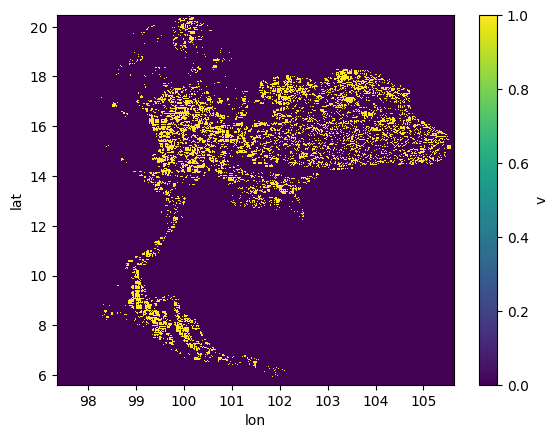

In [70]:
xr_format= xr.open_dataset('Output_SolarWind\\xr_AVA_Wind.nc')
lat = list(xr_format.lat)
lon = list(xr_format.lon)

rasterized_i = rasterized[::-1]

r = xr.DataArray(
    data = rasterized_i,
    coords = dict(
        lat = ('lat',lat),
        lon = ('lon',lon),

    )
)

xr_r = r.to_dataset(name="v")
xr_r['v'] = xr.where( (xr_r['v'] > 0),1,0)
xr_r.to_netcdf(path='Output_SolarWind\\xr_rasterized_largepolygon.nc')
print(xr_r)
xr_r['v'].plot()

In [71]:
mask = None
with rasterio.Env():
    with rasterio.open('Output_SolarWind\\xr_rasterized_largepolygon.nc') as src:
        image = src.read(1) # first band
        results = (
        {'properties': {'raster_val': v}, 'geometry': s}
        for i, (s, v) 
        in enumerate(
            shapes(image, mask=mask, transform=src.transform)))

geoms = list(results)

gpd_polygonized_raster  = gpd.GeoDataFrame.from_features(geoms)
gpd_polygonized_raster.crs = {'init': 'epsg:4326'}
gpd_polygonized_raster= gpd_polygonized_raster.to_crs({'init': 'epsg:3857'})
gpd_polygonized_raster['area_cal'] = gpd_polygonized_raster['geometry'].area / (10**6)
gpd_polygonized_raster['area_cal'] = round(gpd_polygonized_raster['area_cal'],4)
gpd_polygonized_raster = gpd_polygonized_raster.to_crs({'init': 'epsg:4326'})
gpd_polygonized_raster = gpd_polygonized_raster.loc[gpd_polygonized_raster['raster_val'] == 1]
gpd_polygonized_raster.reset_index(inplace=True,drop=True)
gpd_polygonized_raster.reset_index(inplace=True)
gpd_polygonized_raster = gpd_polygonized_raster.rename(columns = {'index' : 'pol_id'})

print(gpd_polygonized_raster)

c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


       pol_id                                           geometry  raster_val  \
0           0  POLYGON ((100.10833 20.41667, 100.11944 20.416...         1.0   
1           1  POLYGON ((100.07500 20.40278, 100.08333 20.402...         1.0   
2           2  POLYGON ((100.13611 20.37500, 100.13611 20.350...         1.0   
3           3  POLYGON ((100.16389 20.37500, 100.18611 20.375...         1.0   
4           4  POLYGON ((100.19444 20.37500, 100.21667 20.375...         1.0   
...       ...                                                ...         ...   
18203   18203  POLYGON ((101.83611 5.93056, 101.83611 5.92778...         1.0   
18204   18204  POLYGON ((101.89722 5.91944, 101.89722 5.91667...         1.0   
18205   18205  POLYGON ((101.83889 5.92778, 101.83889 5.91944...         1.0   
18206   18206  POLYGON ((101.89167 5.91667, 101.89722 5.91667...         1.0   
18207   18207  POLYGON ((101.87500 5.90833, 101.87778 5.90833...         1.0   

       area_cal  
0        4.9990  
1  

In [72]:
df_final_SI_Wind = pd.read_csv('Output_SolarWind\\df_final_SI_Wind.csv')
df_final_SI_Solar = pd.read_csv('Output_SolarWind\\df_final_SI_Solar.csv')
df_final_SI_Wind['area'] = round(df_final_SI_Wind['area'],4)
df_final_SI_Solar['area'] = round(df_final_SI_Solar['area'],4)
df_final_SI_Wind['geometry'] = df_final_SI_Wind['geometry'].apply(wkt.loads)
df_final_SI_Solar['geometry'] = df_final_SI_Solar['geometry'].apply(wkt.loads)
gdp_final_SI_Wind = gpd.GeoDataFrame(df_final_SI_Wind, crs='epsg:4326')
gdp_final_SI_Solar = gpd.GeoDataFrame(df_final_SI_Solar, crs='epsg:4326')
gdp_final_SI_Wind = gdp_final_SI_Wind.set_geometry(gdp_final_SI_Wind['geometry'])
gdp_final_SI_Solar = gdp_final_SI_Solar.set_geometry(gdp_final_SI_Solar['geometry'])
gdp_final_SI_Wind['center'] = gdp_final_SI_Wind['geometry'].centroid
gdp_final_SI_Solar['center'] = gdp_final_SI_Solar['geometry'].centroid

#### Area cal #####
gdp_final_SI_Wind = gdp_final_SI_Wind.to_crs({'init': 'epsg:3857'})
gdp_final_SI_Wind['area_cal'] = gdp_final_SI_Wind['geometry'].area / (10**6)
gdp_final_SI_Wind['area_cal'] = round(gdp_final_SI_Wind['area_cal'],4)
gdp_final_SI_Wind = gdp_final_SI_Wind.to_crs({'init': 'epsg:4326'})

gdp_final_SI_Solar = gdp_final_SI_Solar.to_crs({'init': 'epsg:3857'})
gdp_final_SI_Solar['area_cal'] = gdp_final_SI_Solar['geometry'].area / (10**6)
gdp_final_SI_Solar['area_cal'] = round(gdp_final_SI_Solar['area_cal'],4)
gdp_final_SI_Solar = gdp_final_SI_Solar.to_crs({'init': 'epsg:4326'})


gdp_final_SI_Wind.reset_index(inplace=True,drop=True)
gdp_final_SI_Solar.reset_index(inplace=True,drop=True)

print(gdp_final_SI_Wind)
print(gdp_final_SI_Solar)

C:\Users\EGAT\AppData\Local\Temp\ipykernel_18332\2525545409.py:11: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdp_final_SI_Wind['center'] = gdp_final_SI_Wind['geometry'].centroid
C:\Users\EGAT\AppData\Local\Temp\ipykernel_18332\2525545409.py:12: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdp_final_SI_Solar['center'] = gdp_final_SI_Solar['geometry'].centroid
c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in

      pol_id_wind                                           geometry  \
0               0  POLYGON ((100.10833 20.41667, 100.11944 20.416...   
1               1  POLYGON ((99.99167 20.36944, 99.99444 20.36944...   
2               2  POLYGON ((99.99167 20.33611, 99.99444 20.33611...   
3               3  POLYGON ((99.89167 20.31944, 99.90556 20.31944...   
4               4  POLYGON ((100.03611 20.34167, 100.05000 20.341...   
...           ...                                                ...   
8376         8376  POLYGON ((100.77209 6.67857, 100.77209 6.70661...   
8377         8377  POLYGON ((101.44894 6.48506, 101.44894 6.51494...   
8378         8378  POLYGON ((101.44894 6.52394, 101.44894 6.55383...   
8379         8379  POLYGON ((101.48783 6.48506, 101.48783 6.51494...   
8380         8380  POLYGON ((101.48783 6.52394, 101.48783 6.55383...   

      raster_val     area                      center  final_SI_Wind  area_cal  
0              3   5.1010  POINT (100.09850 20.40539) 

c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


In [73]:
# gpd_polygonized_raster = gpd_polygonized_raster[:100]

gpd_polygonized_raster['area'] = 0

gpd_polygonized_raster['from_pol_id_wind'] = 0
gpd_polygonized_raster['list_pol_id_wind'] = None
gpd_polygonized_raster['SI_Wind'] = 0
gpd_polygonized_raster['area_wind'] = 0
gpd_polygonized_raster['coord_wind'] = 0

gpd_polygonized_raster['from_pol_id_solar'] = 0
gpd_polygonized_raster['list_pol_id_solar'] = None
gpd_polygonized_raster['SI_Solar'] = 0
gpd_polygonized_raster['area_solar'] = 0
gpd_polygonized_raster['coord_solar'] = 0

for i , pol in enumerate(gpd_polygonized_raster['geometry']):
    ##################################### WINNNDD ###########################################################################################################
    gpd_polygonized_raster['from_pol_id_wind'][i] = gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['center'].within(pol)].count()
    if(gpd_polygonized_raster['from_pol_id_wind'][i] > 1 ):
        gpd_polygonized_raster['list_pol_id_wind'][i] = gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['center'].within(pol)].values
        buffer = [poly for poly in (gdp_final_SI_Wind['geometry'].loc[gdp_final_SI_Wind['center'].within(pol)])]
        gpd_polygonized_raster['coord_wind'][i] = shapely.geometry.MultiPolygon(buffer)
        gpd_polygonized_raster['SI_Wind'][i] = gdp_final_SI_Wind['final_SI_Wind'].loc[gdp_final_SI_Wind['center'].within(pol)].mean() 
        # print("wind = ",gpd_polygonized_raster['from_pol_wind_id'][i],gpd_polygonized_raster['wind_area_coord'][i])
    else:
        if(gpd_polygonized_raster['from_pol_id_wind'][i] == 1 ):
            gpd_polygonized_raster['list_pol_id_wind'][i] = gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['center'].within(pol)].values
            buffer = gdp_final_SI_Wind['geometry'].loc[gdp_final_SI_Wind['center'].within(pol)]
            buffer = buffer.reset_index()
            gpd_polygonized_raster['coord_wind'][i] = buffer['geometry'][0]
            gpd_polygonized_raster['SI_Wind'][i] = gdp_final_SI_Wind['final_SI_Wind'].loc[gdp_final_SI_Wind['center'].within(pol)].mean() 
        else:
            gpd_polygonized_raster['list_pol_id_wind'][i] = None
            gpd_polygonized_raster['from_pol_id_wind'][i] = 0
            gpd_polygonized_raster['coord_wind'][i] = None
            gpd_polygonized_raster['SI_Wind'][i] = 0
    gpd_polygonized_raster['area_wind'][i] = (gdp_final_SI_Wind['area'].loc[gdp_final_SI_Wind['center'].within(pol)]).sum()
    ##################################### WINNNDD ###########################################################################################################

    ##################################### Solar ###########################################################################################################
    gpd_polygonized_raster['from_pol_id_solar'][i] = gdp_final_SI_Solar['pol_id_solar'].loc[gdp_final_SI_Solar['center'].within(pol)].count()
    if(gpd_polygonized_raster['from_pol_id_solar'][i] > 1 ):
        gpd_polygonized_raster['list_pol_id_solar'][i] = gdp_final_SI_Solar['pol_id_solar'].loc[gdp_final_SI_Solar['center'].within(pol)].values
        buffer = [poly for poly in (gdp_final_SI_Solar['geometry'].loc[gdp_final_SI_Solar['center'].within(pol)])]
        gpd_polygonized_raster['coord_solar'][i] = shapely.geometry.MultiPolygon(buffer)
        gpd_polygonized_raster['SI_Solar'][i] = gdp_final_SI_Solar['final_SI_Solar'].loc[gdp_final_SI_Solar['center'].within(pol)].mean()   
        # print("solar = ",gpd_polygonized_raster['from_pol_solar_id'][i],gpd_polygonized_raster['solar_area_coord'][i])
    else:
        if(gpd_polygonized_raster['from_pol_id_solar'][i] == 1 ):
            gpd_polygonized_raster['list_pol_id_solar'][i] = gdp_final_SI_Solar['pol_id_solar'].loc[gdp_final_SI_Solar['center'].within(pol)].values
            buffer = gdp_final_SI_Solar['geometry'].loc[gdp_final_SI_Solar['center'].within(pol)]
            buffer = buffer.reset_index()
            gpd_polygonized_raster['coord_solar'][i] = buffer['geometry'][0]
            gpd_polygonized_raster['SI_Solar'][i] = gdp_final_SI_Solar['final_SI_Solar'].loc[gdp_final_SI_Solar['center'].within(pol)].mean()
        else:
            gpd_polygonized_raster['list_pol_id_solar'][i] = None
            gpd_polygonized_raster['from_pol_id_solar'][i] = 0
            gpd_polygonized_raster['coord_solar'][i] = None
            gpd_polygonized_raster['SI_Solar'][i] = 0
    gpd_polygonized_raster['area_solar'][i] = (gdp_final_SI_Solar['area'].loc[gdp_final_SI_Solar['center'].within(pol)]).sum()
    ##################################### Solar ###########################################################################################################

    ##################################### Deal with area issues ###########################################################################################################
        
    if (gpd_polygonized_raster['area_cal'][i] >= 
        (gdp_final_SI_Wind['area_cal'].loc[gdp_final_SI_Wind['center'].within(pol)]).sum()
        + (gdp_final_SI_Solar['area_cal'].loc[gdp_final_SI_Solar['center'].within(pol)]).sum()
    ) :
        gpd_polygonized_raster['area'][i] = (gdp_final_SI_Wind['area'].loc[gdp_final_SI_Wind['center'].within(pol)].sum() + gdp_final_SI_Solar['area'].loc[gdp_final_SI_Solar['center'].within(pol)].sum())
    else :
        gpd_polygonized_raster['area'][i] = max([gdp_final_SI_Wind['area'].loc[gdp_final_SI_Wind['center'].within(pol)].sum(),
                                                gdp_final_SI_Solar['area'].loc[gdp_final_SI_Solar['center'].within(pol)].sum()])
    
    ##################################### Deal with area issues ###########################################################################################################

        
try:
    gpd_polygonized_raster = gpd_polygonized_raster.drop(columns='raster_val')
except:
    None

gpd_polygonized_raster.reset_index(inplace=True,drop=True)
print(gpd_polygonized_raster)



C:\Users\EGAT\AppData\Local\Temp\ipykernel_18332\3539936518.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gpd_polygonized_raster['from_pol_id_wind'][i] = gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['center'].within(pol)].count()
C:\Users\EGAT\AppData\Local\Temp\ipykernel_18332\3539936518.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  gpd_polygonized_raster['list_pol_id_wind'][i] = gdp_final_SI_Wind['pol_id_wind'].loc[gdp_final_SI_Wind['center'].within(pol)].values
C:\Users\EGAT\AppData\Local\Temp\ipykernel_18332\3539936518.py:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of 

       pol_id                                           geometry  area_cal  \
0           0  POLYGON ((100.10833 20.41667, 100.11944 20.416...    4.9990   
1           1  POLYGON ((100.07500 20.40278, 100.08333 20.402...    2.3463   
2           2  POLYGON ((100.13611 20.37500, 100.13611 20.350...    7.3433   
3           3  POLYGON ((100.16389 20.37500, 100.18611 20.375...    7.9553   
4           4  POLYGON ((100.19444 20.37500, 100.21667 20.375...    7.9553   
...       ...                                                ...       ...   
18203   18203  POLYGON ((101.83611 5.93056, 101.83611 5.92778...    0.0961   
18204   18204  POLYGON ((101.89722 5.91944, 101.89722 5.91667...    0.0961   
18205   18205  POLYGON ((101.83889 5.92778, 101.83889 5.91944...    2.1149   
18206   18206  POLYGON ((101.89167 5.91667, 101.89722 5.91667...    0.5768   
18207   18207  POLYGON ((101.87500 5.90833, 101.87778 5.90833...    1.5380   

          area  from_pol_id_wind list_pol_id_wind   SI_Wind  ar

In [74]:
gpd_polygonized_raster.to_csv('Output_SolarWind\\df_final_SI_combined_SolarWind.csv',index=False)

In [75]:
region = pd.read_csv('Data\\Region.csv',index_col=False)
thailandmap = gpd.read_file('Data\\tha_admbnda_adm1_rtsd_20220121\\tha_admbnda_adm1_rtsd_20220121.shp')

thailandmap.crs = {'init': 'epsg:4326'}
list_region = []

count = 0
for i in thailandmap['ADM1_TH']:
    r = region['region'].loc[region['province'] == i]
    try : 
        # print(i,r.values[0])
        list_region.append(r.values[0])
    except :
        print(i,'xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx')
        list_region.append('xxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxxx')       
    
thailandmap['region'] = list_region
thailandmap['center'] = thailandmap['geometry'].centroid
thailandmap = thailandmap.set_geometry('center')
thailandmap = thailandmap.drop(columns = 'geometry')

gpd_polygonized_raster['region'] = 'unk'
gpd_polygonized_raster['center'] = gpd_polygonized_raster['geometry'].centroid
gpd_polygonized_raster = gpd_polygonized_raster.set_geometry('center')


c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\pyproj\crs\crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
C:\Users\EGAT\AppData\Local\Temp\ipykernel_18332\561258906.py:18: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  thailandmap['center'] = thailandmap['geometry'].centroid
C:\Users\EGAT\AppData\Local\Temp\ipykernel_18332\561258906.py:23: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gpd_polygonized_ra

In [76]:
gpd_polygonized_raster_2 = gpd.sjoin_nearest(gpd_polygonized_raster,thailandmap,how='left')
print(gpd_polygonized_raster_2)

c:\Users\EGAT\AppData\Local\Programs\Python\Python311\Lib\site-packages\geopandas\array.py:364: UserWarning: Geometry is in a geographic CRS. Results from 'sjoin_nearest' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  warnings.warn(


       pol_id                                           geometry  area_cal  \
0           0  POLYGON ((100.10833 20.41667, 100.11944 20.416...    4.9990   
1           1  POLYGON ((100.07500 20.40278, 100.08333 20.402...    2.3463   
2           2  POLYGON ((100.13611 20.37500, 100.13611 20.350...    7.3433   
3           3  POLYGON ((100.16389 20.37500, 100.18611 20.375...    7.9553   
4           4  POLYGON ((100.19444 20.37500, 100.21667 20.375...    7.9553   
...       ...                                                ...       ...   
18203   18203  POLYGON ((101.83611 5.93056, 101.83611 5.92778...    0.0961   
18204   18204  POLYGON ((101.89722 5.91944, 101.89722 5.91667...    0.0961   
18205   18205  POLYGON ((101.83889 5.92778, 101.83889 5.91944...    2.1149   
18206   18206  POLYGON ((101.89167 5.91667, 101.89722 5.91667...    0.5768   
18207   18207  POLYGON ((101.87500 5.90833, 101.87778 5.90833...    1.5380   

          area  from_pol_id_wind list_pol_id_wind   SI_Wind  ar

In [77]:
print(gpd_polygonized_raster_2.columns)
gpd_polygonized_raster_2 = gpd_polygonized_raster_2.drop(columns=
                                                         ['index_right'
                                                          ,'Shape_Leng'
                                                          ,'Shape_Area'
                                                          ,'ADM1ALT2EN'
                                                          ,'ADM1_PCODE'
                                                          ,'ADM1_REF'
                                                          ,'ADM1ALT1EN'
                                                          ,'ADM1ALT2EN'
                                                          ,'ADM1ALT1TH'
                                                          ,'ADM1ALT2EN'
                                                          ,'ADM1ALT1TH'
                                                          ,'ADM1ALT2TH'
                                                          ,'ADM0_EN'
                                                          ,'ADM0_TH'
                                                          ,'ADM0_PCODE'
                                                          ,'date'
                                                          ,'validOn'
                                                          ,'validTo'
                                                          ,'center'
                                                          ,'area_cal'
                                                          ])
print(gpd_polygonized_raster_2.columns)

Index(['pol_id', 'geometry', 'area_cal', 'area', 'from_pol_id_wind',
       'list_pol_id_wind', 'SI_Wind', 'area_wind', 'coord_wind',
       'from_pol_id_solar', 'list_pol_id_solar', 'SI_Solar', 'area_solar',
       'coord_solar', 'region_left', 'center', 'index_right', 'Shape_Leng',
       'Shape_Area', 'ADM1_EN', 'ADM1_TH', 'ADM1_PCODE', 'ADM1_REF',
       'ADM1ALT1EN', 'ADM1ALT2EN', 'ADM1ALT1TH', 'ADM1ALT2TH', 'ADM0_EN',
       'ADM0_TH', 'ADM0_PCODE', 'date', 'validOn', 'validTo', 'region_right'],
      dtype='object')
Index(['pol_id', 'geometry', 'area', 'from_pol_id_wind', 'list_pol_id_wind',
       'SI_Wind', 'area_wind', 'coord_wind', 'from_pol_id_solar',
       'list_pol_id_solar', 'SI_Solar', 'area_solar', 'coord_solar',
       'region_left', 'ADM1_EN', 'ADM1_TH', 'region_right'],
      dtype='object')


In [78]:
gpd_polygonized_raster_2 = gpd_polygonized_raster_2.drop(columns = 'region_left')
gpd_polygonized_raster_2 = gpd_polygonized_raster_2.rename(columns= {'region_right':'region'})
gpd_polygonized_raster_2 = gpd_polygonized_raster_2.drop_duplicates('pol_id')
print(gpd_polygonized_raster_2)

       pol_id                                           geometry     area  \
0           0  POLYGON ((100.10833 20.41667, 100.11944 20.416...   5.1010   
1           1  POLYGON ((100.07500 20.40278, 100.08333 20.402...   2.2443   
2           2  POLYGON ((100.13611 20.37500, 100.13611 20.350...   8.9662   
3           3  POLYGON ((100.16389 20.37500, 100.18611 20.375...  12.0108   
4           4  POLYGON ((100.19444 20.37500, 100.21667 20.375...   8.9662   
...       ...                                                ...      ...   
18203   18203  POLYGON ((101.83611 5.93056, 101.83611 5.92778...   0.0000   
18204   18204  POLYGON ((101.89722 5.91944, 101.89722 5.91667...   0.0000   
18205   18205  POLYGON ((101.83889 5.92778, 101.83889 5.91944...   2.2110   
18206   18206  POLYGON ((101.89167 5.91667, 101.89722 5.91667...   0.6729   
18207   18207  POLYGON ((101.87500 5.90833, 101.87778 5.90833...   1.5380   

       from_pol_id_wind list_pol_id_wind   SI_Wind  area_wind  \
0         

In [79]:
gpd_polygonized_raster_2.to_csv('Output_SolarWind\\df_final_SI_combined_SolarWind.csv',index=False,encoding="utf-8-sig")

In [80]:
df = pd.read_csv('Output_SolarWind\\df_final_SI_combined_SolarWind.csv')
df = df.drop(columns=[
    'geometry',
    'coord_wind',
    'coord_solar',
    'ADM1_EN',
    'ADM1_TH'
    ])

In [81]:
df = df.drop_duplicates('pol_id')
print(df)

       pol_id     area  from_pol_id_wind list_pol_id_wind   SI_Wind  \
0           0   5.1010                 1              [0]  1.827924   
1           1   2.2443                 0              NaN  0.000000   
2           2   8.9662                 1           [3713]  1.764193   
3           3  12.0108                 1           [3717]  1.790038   
4           4   8.9662                 1           [3719]  1.779494   
...       ...      ...               ...              ...       ...   
18203   18203   0.0000                 0              NaN  0.000000   
18204   18204   0.0000                 0              NaN  0.000000   
18205   18205   2.2110                 0              NaN  0.000000   
18206   18206   0.6729                 0              NaN  0.000000   
18207   18207   1.5380                 0              NaN  0.000000   

       area_wind  from_pol_id_solar          list_pol_id_solar  SI_Solar  \
0         5.1010                  1                        [0]  2.15227

In [82]:
df = df.reset_index(drop=True)
print(df)

       pol_id     area  from_pol_id_wind list_pol_id_wind   SI_Wind  \
0           0   5.1010                 1              [0]  1.827924   
1           1   2.2443                 0              NaN  0.000000   
2           2   8.9662                 1           [3713]  1.764193   
3           3  12.0108                 1           [3717]  1.790038   
4           4   8.9662                 1           [3719]  1.779494   
...       ...      ...               ...              ...       ...   
18203   18203   0.0000                 0              NaN  0.000000   
18204   18204   0.0000                 0              NaN  0.000000   
18205   18205   2.2110                 0              NaN  0.000000   
18206   18206   0.6729                 0              NaN  0.000000   
18207   18207   1.5380                 0              NaN  0.000000   

       area_wind  from_pol_id_solar          list_pol_id_solar  SI_Solar  \
0         5.1010                  1                        [0]  2.15227

In [83]:
try:
    df = df.set_index('pol_id')
except:
    None

try:
    xr = xr.Dataset.from_dataframe(df)
except:
    None

xr.to_netcdf(path='Output_SolarWind\\xr_final_SI_combined_SolarWind.nc')
print(xr)

<xarray.Dataset>
Dimensions:            (pol_id: 18208)
Coordinates:
  * pol_id             (pol_id) int64 0 1 2 3 4 ... 18204 18205 18206 18207
Data variables:
    area               (pol_id) float64 5.101 2.244 8.966 ... 2.211 0.6729 1.538
    from_pol_id_wind   (pol_id) int64 1 0 1 1 1 1 0 0 1 1 ... 0 0 0 0 0 0 0 0 0
    list_pol_id_wind   (pol_id) object '[0]' nan '[3713]' ... nan nan nan
    SI_Wind            (pol_id) float64 1.828 0.0 1.764 1.79 ... 0.0 0.0 0.0 0.0
    area_wind          (pol_id) float64 5.101 0.0 5.922 5.922 ... 0.0 0.0 0.0
    from_pol_id_solar  (pol_id) int64 1 1 2 4 2 1 1 1 3 4 ... 0 1 1 1 0 0 1 1 1
    list_pol_id_solar  (pol_id) object '[0]' '[1]' ... '[11368]' '[11369]'
    SI_Solar           (pol_id) float64 2.152 2.145 1.963 ... 2.31 2.453 2.332
    area_solar         (pol_id) float64 3.877 2.244 3.045 ... 2.211 0.6729 1.538
    region             (pol_id) object 'R4' 'R4' 'R4' 'R4' ... 'R3' 'R3' 'R3'
